# Dog Breed classification with Deep Learning methods

- Configuration

In [1]:
# system libraries
import os
import warnings
warnings.filterwarnings("ignore")
from time import time
import gc

# data structure libraries
import numpy as np
import pandas as pd

# data visualisation libraries
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from skimage.transform import resize
from IPython.display import SVG
import seaborn as sns

# deep learning libraries
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, Sequential
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.data import experimental
from tensorflow.keras.utils import plot_model, model_to_dot

In [2]:
# Google Drive connexion
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


The aim of this project is to realised a dog breed classifier. This project has two main parts. In a first step, the model building was performed on a small subsamples of breeds. After model selection, all breeds are included in order to create our application. 

Model building and selection will be separated in two parts too. In a first part, we explore CNN from scratch and effects of preprocessing and data augmentation on 

# Trial with seven breeds of dogs - No preprocessing + Convnet

In order to develop our computer vision system, seven breeds of dogs were chosen. This choice was here to simplify training of the different model and understanding of the different steps. 

In [3]:
# loading dataset and selecting images parameters
path = '/content/drive/My Drive/Ingénieur ML - OC/P6/datasets/test_samples_reduced/'
img_width, img_height = 224, 224
channels = 3
batch_size = 32
image_arr_size= img_width * img_height * channels

## 1) Data preparation

With the help of Tensorflow functions, train and validation set have been created. Caracterics of images had been define as follow:
- Width: 224,
- Height: 224,
- Channels: 3,

Each parameters have been saved in variables in order to help the replicability of our methods. 

In [4]:
# Creating a train set
train_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="training",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 951 files for training.


In [5]:
# Creating a validation set
val_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="validation",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 237 files for validation.


In [6]:
# Displaying names of breed
class_names = train_set.class_names
print(class_names)

['n02088238-basset', 'n02088364-beagle', 'n02096294-Australian_terrier', 'n02099712-Labrador_retriever', 'n02102480-Sussex_spaniel', 'n02105056-groenendael', 'n02106166-Border_collie']


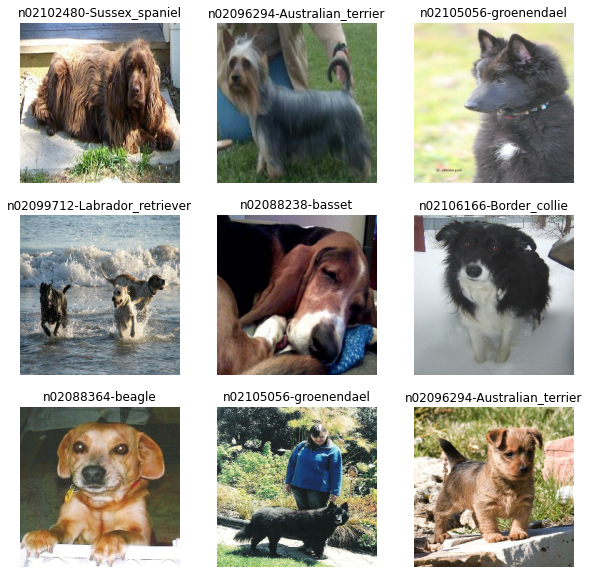

In [7]:
# Displaying some pictures of train set
plt.figure(figsize=(10, 10))
for images, labels in train_set.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [8]:
for image_batch, labels_batch in train_set:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 224, 224, 3)
(32,)


Two datasets was created with our seven breeds. Training dataset contains 80% of the data and validation dataset contains 20%. 

## 2) Convnet modelisation

Once datasets created, we create our first CNN.

In [9]:
num_classes = 7

# Architecture of our CNN
model = keras.Sequential()
model.add(keras.Input(shape=(img_height, img_width, channels)))
model.add(layers.Rescaling(1./255))
model.add(layers.Conv2D(128, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(64, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(32, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(num_classes, activation="softmax"))

model.compile(
  optimizer='adam', 
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [10]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling (Rescaling)       (None, 224, 224, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 222, 222, 128)     3584      
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 128)    0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      73792     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 52, 52, 32)        1

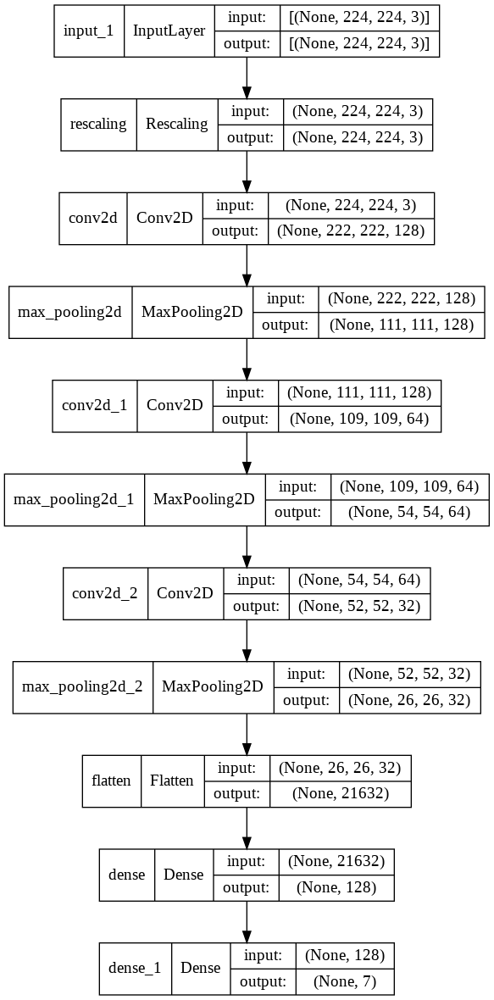

In [11]:
# Displaying model
plot_model(model, show_shapes=True, show_layer_names=True)

Our model contains rescaling layer. This layer is here to transform pixel value in a value between [0, 1]. Three convolutional layers and three pooling layers are presented in order to select pertinent information in each images. Finally flatten and fully connected layers are used in order to transform result in a prediction. This prediction is a probability to belong to a class. 

In [12]:
t0 = time()

epochs = 20

# training model + time measure
history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 6s 100ms/step - loss: 1.9792 - accuracy: 0.1661 - val_loss: 1.9167 - val_accuracy: 0.2363
Epoch 2/20
30/30 [==============================] - 3s 74ms/step - loss: 1.8467 - accuracy: 0.2482 - val_loss: 1.7290 - val_accuracy: 0.3291
Epoch 3/20
30/30 [==============================] - 3s 74ms/step - loss: 1.6207 - accuracy: 0.3733 - val_loss: 1.6917 - val_accuracy: 0.3207
Epoch 4/20
30/30 [==============================] - 2s 74ms/step - loss: 1.0970 - accuracy: 0.5941 - val_loss: 1.9719 - val_accuracy: 0.3291
Epoch 5/20
30/30 [==============================] - 3s 74ms/step - loss: 0.6101 - accuracy: 0.7792 - val_loss: 2.2436 - val_accuracy: 0.3376
Epoch 6/20
30/30 [==============================] - 3s 74ms/step - loss: 0.3100 - accuracy: 0.8970 - val_loss: 3.0651 - val_accuracy: 0.3376
Epoch 7/20
30/30 [==============================] - 3s 74ms/step - loss: 0.1228 - accuracy: 0.9569 - val_loss: 3.7199 - val_accuracy: 0.3165
Epoch 8/20
3

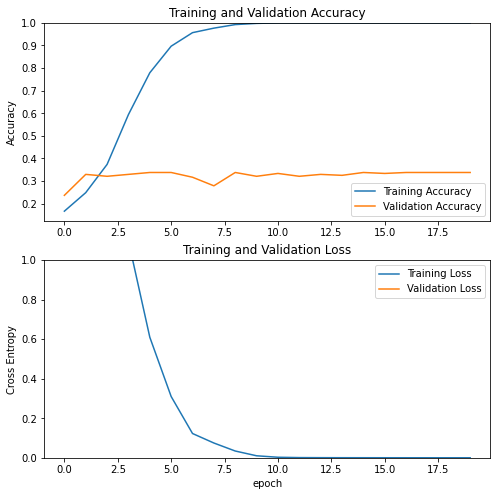

In [13]:
# Accuracy and Loss graphical representation
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

This first trial shows that a CNN realized poor performance. This CNN is speed (1'30" for the training) but we can see overfitting. In order to ameliore our performance, a second trial will be realized with preprocessings of our images. 

In [14]:
del train_set
del val_set
del model
del history

gc.collect()

5638

# Trial with seven breeds - Preprocessing of images + Convnet

## 1) Image Preprocessing

Before modeling and using a new CNN, data will be preprocessed. Some methods will be used. Among them, whitening or rotation will be tried. This step has two aims : 
- Better performance with CNN structure ; 
- Data Augmentation. 

In [15]:
# create generator with whitening and rotation

img_gen = ImageDataGenerator(rescale=1./255,
                             zca_whitening=True,
                             horizontal_flip=True,
                             vertical_flip=True,
                             validation_split=0.2,
                             dtype=tf.float32)

In [16]:
# transform & create train set

train_generator = img_gen.flow_from_directory(
    path,
    subset="training",
    seed=42,
    class_mode='sparse',
    target_size=(img_height, img_width), 
    color_mode='rgb',
    batch_size=batch_size)

Found 951 images belonging to 7 classes.


In [17]:
# transform & create validation set

validation_generator = img_gen.flow_from_directory(
    path,
    subset="validation",
    seed=42,
    class_mode='sparse',
    target_size=(img_height, img_width), 
    color_mode='rgb',
    batch_size=batch_size)

Found 237 images belonging to 7 classes.


## 2) Convnet modelisation

The architecture of our CNN is the same than the first trial. Input data are different because of data preprocessing and augmentation. 

In [18]:
num_classes = 7

# Architecture of our CNN
model = keras.Sequential()
model.add(keras.Input(shape=(img_height, img_width, channels)))
model.add(layers.Conv2D(128, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(64, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Conv2D(32, 3, activation='relu'))
model.add(layers.MaxPooling2D())
model.add(layers.Flatten())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(num_classes, activation="softmax"))

model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [19]:
t0 = time()

epochs = 20

# training model+ time measurement

history = model.fit_generator(
  train_generator,
  steps_per_epoch = train_generator.samples // batch_size,
  validation_data = validation_generator, 
  validation_steps = validation_generator.samples // batch_size,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
29/29 [==============================] - 6s 188ms/step - loss: 1.9872 - accuracy: 0.1676 - val_loss: 1.9398 - val_accuracy: 0.1562
Epoch 2/20
29/29 [==============================] - 5s 178ms/step - loss: 1.9394 - accuracy: 0.1828 - val_loss: 1.9442 - val_accuracy: 0.1741
Epoch 3/20
29/29 [==============================] - 5s 179ms/step - loss: 1.9432 - accuracy: 0.1730 - val_loss: 1.9387 - val_accuracy: 0.2054
Epoch 4/20
29/29 [==============================] - 5s 177ms/step - loss: 1.9423 - accuracy: 0.1861 - val_loss: 1.9312 - val_accuracy: 0.1920
Epoch 5/20
29/29 [==============================] - 5s 178ms/step - loss: 1.9043 - accuracy: 0.2381 - val_loss: 2.0080 - val_accuracy: 0.1696
Epoch 6/20
29/29 [==============================] - 5s 178ms/step - loss: 1.8635 - accuracy: 0.2916 - val_loss: 1.8008 - val_accuracy: 0.2366
Epoch 7/20
29/29 [==============================] - 5s 181ms/step - loss: 1.7333 - accuracy: 0.3025 - val_loss: 1.7860 - val_accuracy: 0.2857
Epoch 

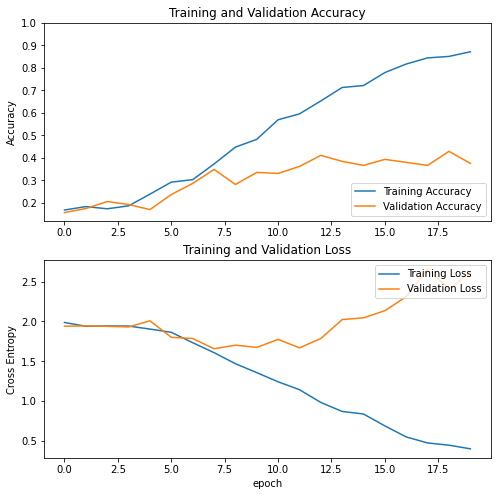

In [20]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([min(plt.ylim()),max(plt.ylim())])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [21]:
del validation_generator
del train_generator
del model
del history
del img_gen

gc.collect()

7738

Performances are slicy better and time for the training is less important. However, some pre-trained models can help us to have better performance. In a second approach, we will use transfer learning methods. 

# Transfer Learning

As seen before, data preprocessing and preparation improve accuracy of our models.

## 1) Data Preparation

In [22]:
# Creating train set

train_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="training",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 951 files for training.


In [23]:
# Creating validation set

val_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="validation",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 1188 files belonging to 7 classes.
Using 237 files for validation.


In [24]:
# Creating test set

val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [25]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 7
Number of test batches: 1


In [26]:
AUTOTUNE = tf.data.AUTOTUNE

train_set = train_set.prefetch(buffer_size=AUTOTUNE)
val_set = val_set.prefetch(buffer_size=AUTOTUNE)
test_set = test_set.prefetch(buffer_size=AUTOTUNE)

In [27]:
# data augmentation layer

data_augmentation = tf.keras.Sequential([
  layers.RandomFlip('horizontal_and_vertical', seed=42),
  layers.RandomRotation(0.2)
])

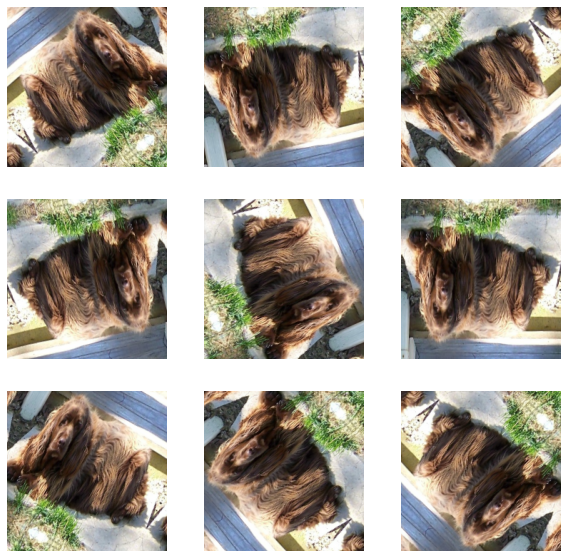

In [28]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

## 2) Transfer Learning with VGG19

### Implementation

First pre-trained model is VGG19. It is a variant of VGG16, which contains 19 layers. 

In [29]:
img_shape = img_height, img_width, channels

In [30]:
num_classes = 7

In [31]:
preprocess_input = keras.applications.vgg19.preprocess_input
rescale = layers.Rescaling(1./255, offset=-1)

In [32]:
base_model = keras.applications.vgg19.VGG19(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [33]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [34]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 512)


In [35]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [36]:
# Freezing 11 layers and training 8
for layer in base_model.layers[:8]:
  base_model.trainable = False

In [37]:
base_model.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

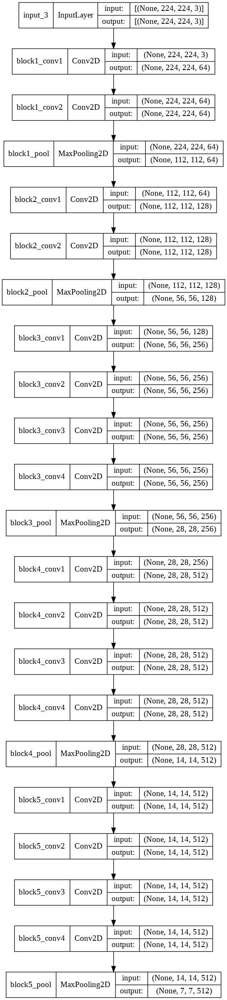

In [38]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [39]:
# Architecture of VGG19 with input layers, data augmentation and preprocessing layers

inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [40]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [41]:
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential_2 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 tf.__operators__.getitem (S  (None, 224, 224, 3)      0         
 licingOpLambda)                                                 
                                                                 
 tf.nn.bias_add (TFOpLambda)  (None, 224, 224, 3)      0         
                                                                 
 vgg19 (Functional)          (None, 7, 7, 512)         20024384  
                                                                 
 global_average_pooling2d (G  (None, 512)              0         
 lobalAveragePooling2D)                                      

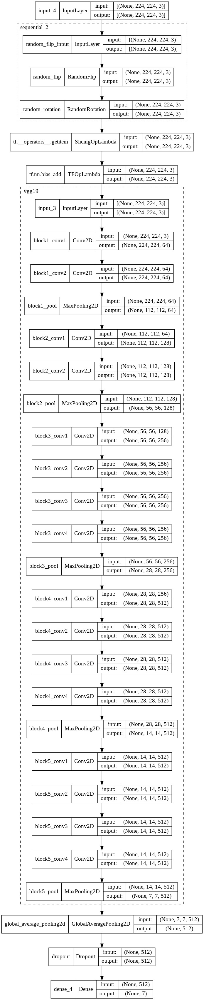

In [42]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [43]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 11s 232ms/step - loss: 8.6970 - accuracy: 0.1640 - val_loss: 4.5312 - val_accuracy: 0.3220
Epoch 2/20
30/30 [==============================] - 3s 105ms/step - loss: 4.1282 - accuracy: 0.3386 - val_loss: 1.9650 - val_accuracy: 0.5805
Epoch 3/20
30/30 [==============================] - 3s 105ms/step - loss: 2.8008 - accuracy: 0.4921 - val_loss: 1.3387 - val_accuracy: 0.7073
Epoch 4/20
30/30 [==============================] - 3s 105ms/step - loss: 1.9478 - accuracy: 0.5657 - val_loss: 0.8516 - val_accuracy: 0.7951
Epoch 5/20
30/30 [==============================] - 3s 105ms/step - loss: 1.6956 - accuracy: 0.6540 - val_loss: 0.7512 - val_accuracy: 0.8439
Epoch 6/20
30/30 [==============================] - 3s 105ms/step - loss: 1.4563 - accuracy: 0.6477 - val_loss: 0.5982 - val_accuracy: 0.8439
Epoch 7/20
30/30 [==============================] - 3s 105ms/step - loss: 1.2230 - accuracy: 0.6856 - val_loss: 0.6544 - val_accuracy: 0.8683
Epoch

In [44]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

7/7 [==============================] - 1s 69ms/step - loss: 0.4615 - accuracy: 0.8927
initial loss: 0.46
initial accuracy: 0.89


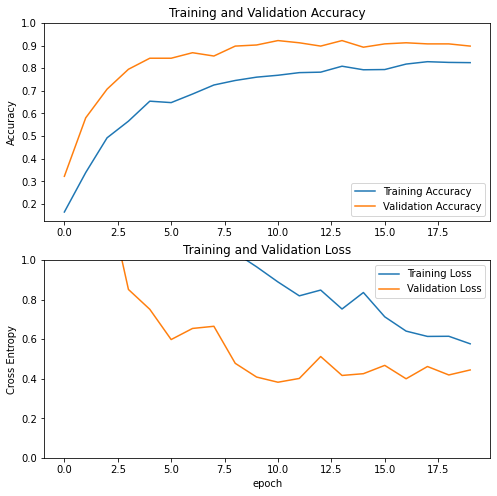

In [45]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

Performances are better with VGG19 than CNN from scratch and training time are less important. Second step is fine-tuning of our model. 

### Fine-tuning

In [46]:
base_model.trainable = True

In [47]:
# Fine-tune from this layer onwards
fine_tune_at = 5

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [48]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 3s 105ms/step - loss: 0.6347 - accuracy: 0.8160 - val_loss: 0.3745 - val_accuracy: 0.9317
Epoch 21/40
30/30 [==============================] - 3s 106ms/step - loss: 0.5696 - accuracy: 0.8286 - val_loss: 0.3940 - val_accuracy: 0.8976
Epoch 22/40
30/30 [==============================] - 3s 106ms/step - loss: 0.5100 - accuracy: 0.8507 - val_loss: 0.3675 - val_accuracy: 0.9317
Epoch 23/40
30/30 [==============================] - 3s 105ms/step - loss: 0.4865 - accuracy: 0.8433 - val_loss: 0.3739 - val_accuracy: 0.9073
Epoch 24/40
30/30 [==============================] - 3s 106ms/step - loss: 0.4938 - accuracy: 0.8496 - val_loss: 0.3332 - val_accuracy: 0.9171
Epoch 25/40
30/30 [==============================] - 3s 106ms/step - loss: 0.4666 - accuracy: 0.8475 - val_loss: 0.5081 - val_accuracy: 0.8976
Epoch 26/40
30/30 [==============================] - 3s 106ms/step - loss: 0.4406 - accuracy: 0.8517 - val_loss: 0.4220 - val_accuracy: 0.9122

In [49]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

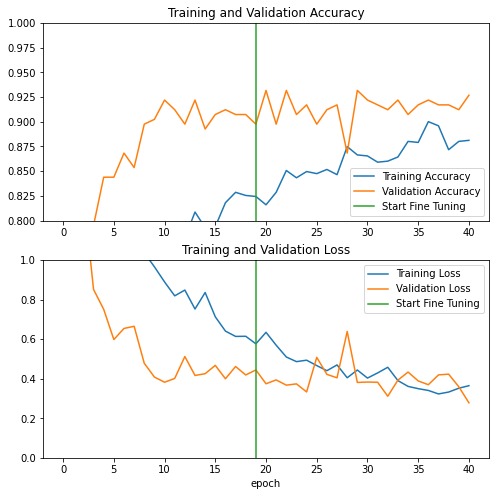

In [50]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [51]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 356ms/step - loss: 0.1639 - accuracy: 0.9375
Test accuracy : 0.9375


VGG19 obtains excellent performant on the test set. However, we explore others architectures in order to improve our resultat. 

In [52]:
del model
del base_model
del history
del loss0, accuracy0
del accuracy
del rescale
del test_set

gc.collect()

52731

## 3) Transfer Learning with ResNet

### Implementation

Second architecture is ResNet50. This model is more impressive than VGG19. It counts 150 layers.

In [53]:
rescale = layers.Rescaling(1./255, offset=-1)
preprocess_input = keras.applications.resnet_v2.preprocess_input
base_model = keras.applications.resnet_v2.ResNet50V2(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [54]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [55]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [56]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 6
Number of test batches: 1


In [57]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2048)


In [58]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [59]:
for layer in base_model.layers[:8]:
  base_model.trainable = False

In [60]:
base_model.summary()

Model: "resnet50v2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_5[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                         

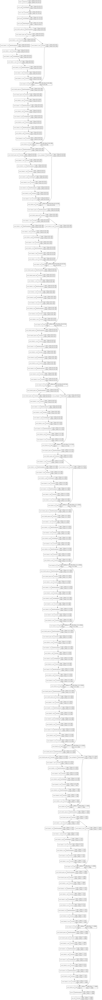

In [61]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [62]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
x = layers.Flatten()(x) 
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [63]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [64]:
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 sequential_2 (Sequential)   (None, 224, 224, 3)       0         
                                                                 
 tf.math.truediv (TFOpLambda  (None, 224, 224, 3)      0         
 )                                                               
                                                                 
 tf.math.subtract (TFOpLambd  (None, 224, 224, 3)      0         
 a)                                                              
                                                                 
 resnet50v2 (Functional)     (None, 7, 7, 2048)        23564800  
                                                                 
 global_average_pooling2d_1   (None, 2048)             0   

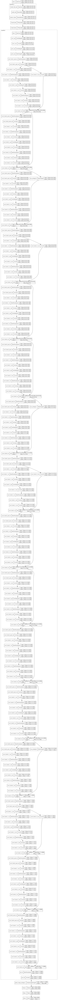

In [65]:
SVG(model_to_dot(model).create(prog='dot', format='svg'))
plot_model(model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [66]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)


print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 7s 125ms/step - loss: 2.7599 - accuracy: 0.3007 - val_loss: 0.6843 - val_accuracy: 0.7225
Epoch 2/20
30/30 [==============================] - 3s 78ms/step - loss: 1.4188 - accuracy: 0.5626 - val_loss: 0.3105 - val_accuracy: 0.9017
Epoch 3/20
30/30 [==============================] - 3s 78ms/step - loss: 1.0519 - accuracy: 0.6509 - val_loss: 0.1740 - val_accuracy: 0.9422
Epoch 4/20
30/30 [==============================] - 3s 77ms/step - loss: 0.8861 - accuracy: 0.7203 - val_loss: 0.2202 - val_accuracy: 0.9133
Epoch 5/20
30/30 [==============================] - 3s 78ms/step - loss: 0.7653 - accuracy: 0.7560 - val_loss: 0.1230 - val_accuracy: 0.9653
Epoch 6/20
30/30 [==============================] - 3s 78ms/step - loss: 0.6670 - accuracy: 0.7771 - val_loss: 0.2025 - val_accuracy: 0.9249
Epoch 7/20
30/30 [==============================] - 3s 78ms/step - loss: 0.6251 - accuracy: 0.7844 - val_loss: 0.1794 - val_accuracy: 0.9306
Epoch 8/20
3

In [67]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

6/6 [==============================] - 1s 48ms/step - loss: 0.1770 - accuracy: 0.9422
initial loss: 0.18
initial accuracy: 0.94


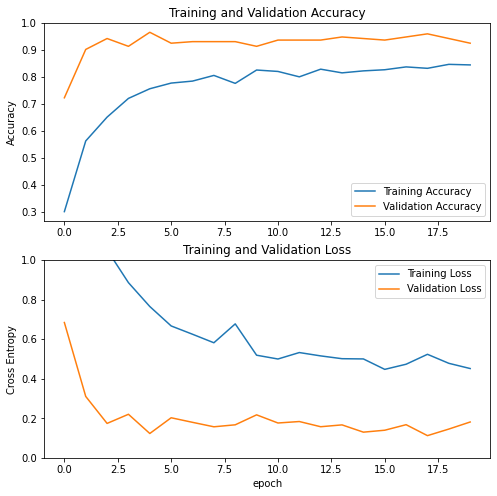

In [68]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### Fine-tuning

In [69]:
base_model.trainable = True

In [70]:
# Fine-tune from this layer onwards
fine_tune_at = 5

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [71]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)


print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 3s 78ms/step - loss: 0.3731 - accuracy: 0.8549 - val_loss: 0.1389 - val_accuracy: 0.9422
Epoch 21/40
30/30 [==============================] - 3s 78ms/step - loss: 0.4651 - accuracy: 0.8444 - val_loss: 0.1323 - val_accuracy: 0.9422
Epoch 22/40
30/30 [==============================] - 3s 78ms/step - loss: 0.4281 - accuracy: 0.8475 - val_loss: 0.1649 - val_accuracy: 0.9364
Epoch 23/40
30/30 [==============================] - 3s 78ms/step - loss: 0.4259 - accuracy: 0.8423 - val_loss: 0.1712 - val_accuracy: 0.9306
Epoch 24/40
30/30 [==============================] - 3s 77ms/step - loss: 0.3990 - accuracy: 0.8465 - val_loss: 0.1001 - val_accuracy: 0.9711
Epoch 25/40
30/30 [==============================] - 3s 78ms/step - loss: 0.4336 - accuracy: 0.8444 - val_loss: 0.1729 - val_accuracy: 0.9306
Epoch 26/40
30/30 [==============================] - 3s 78ms/step - loss: 0.4049 - accuracy: 0.8538 - val_loss: 0.1364 - val_accuracy: 0.9480
Epoch 

In [72]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

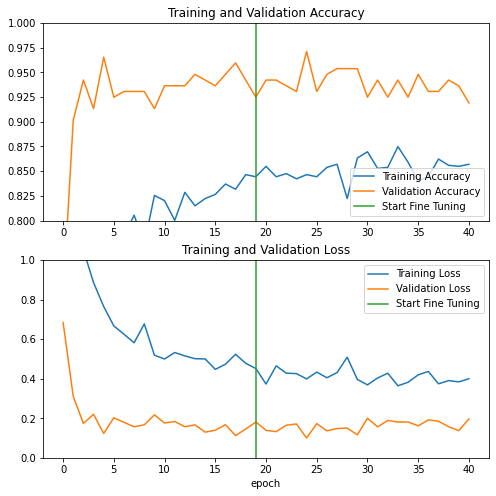

In [73]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [74]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 342ms/step - loss: 0.2693 - accuracy: 0.9062
Test accuracy : 0.90625


In [75]:
del model
del base_model
del history
del loss0, accuracy0
del accuracy

gc.collect()

12465

## 4) Inception V3

Third model is Inception V3. It is a model with more than 300 layers. We can expect best performance for this model. 

### Implementation

In [76]:
rescale = layers.Rescaling(1./255, offset=-1)
preprocess_input = keras.applications.inception_v3.preprocess_input
base_model = keras.applications.inception_v3.InceptionV3(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [77]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [78]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [79]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 5
Number of test batches: 1


In [80]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2048)


In [81]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [82]:
for layer in base_model.layers[:10]:
  base_model.trainable = False

In [83]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_6 (Conv2D)              (None, 111, 111, 32  864         ['input_7[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 111, 111, 32  96         ['conv2d_6[0][0]']               
 alization)                     )                                                      

In [84]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [85]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [86]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [87]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 8s 126ms/step - loss: 2.2294 - accuracy: 0.3512 - val_loss: 0.3510 - val_accuracy: 0.9220
Epoch 2/20
30/30 [==============================] - 2s 70ms/step - loss: 1.1024 - accuracy: 0.6498 - val_loss: 0.1760 - val_accuracy: 0.9362
Epoch 3/20
30/30 [==============================] - 2s 71ms/step - loss: 0.8627 - accuracy: 0.7497 - val_loss: 0.1502 - val_accuracy: 0.9645
Epoch 4/20
30/30 [==============================] - 2s 72ms/step - loss: 0.7249 - accuracy: 0.7697 - val_loss: 0.1056 - val_accuracy: 0.9716
Epoch 5/20
30/30 [==============================] - 2s 70ms/step - loss: 0.7357 - accuracy: 0.7739 - val_loss: 0.1053 - val_accuracy: 0.9645
Epoch 6/20
30/30 [==============================] - 2s 72ms/step - loss: 0.6219 - accuracy: 0.7918 - val_loss: 0.1259 - val_accuracy: 0.9645
Epoch 7/20
30/30 [==============================] - 2s 70ms/step - loss: 0.7076 - accuracy: 0.7655 - val_loss: 0.0663 - val_accuracy: 0.9716
Epoch 8/20
3

In [88]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

5/5 [==============================] - 1s 42ms/step - loss: 0.0612 - accuracy: 0.9787
initial loss: 0.06
initial accuracy: 0.98


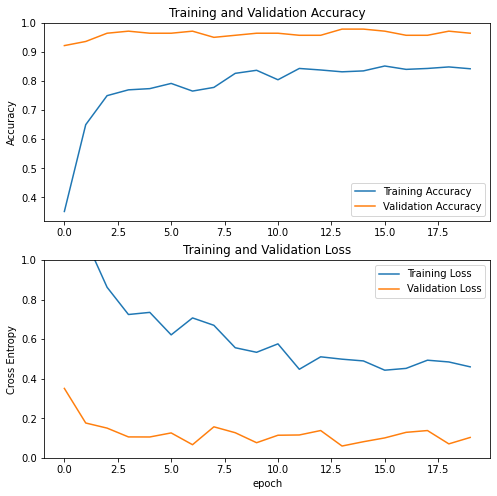

In [89]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### Fine-tuning

In [90]:
base_model.trainable = True

In [91]:
# Fine-tune from this layer onwards
fine_tune_at = 10

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [92]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 2s 71ms/step - loss: 0.4078 - accuracy: 0.8675 - val_loss: 0.1068 - val_accuracy: 0.9645
Epoch 21/40
30/30 [==============================] - 2s 71ms/step - loss: 0.4371 - accuracy: 0.8465 - val_loss: 0.0760 - val_accuracy: 0.9787
Epoch 22/40
30/30 [==============================] - 2s 70ms/step - loss: 0.4254 - accuracy: 0.8423 - val_loss: 0.0579 - val_accuracy: 0.9716
Epoch 23/40
30/30 [==============================] - 2s 71ms/step - loss: 0.4100 - accuracy: 0.8507 - val_loss: 0.0907 - val_accuracy: 0.9787
Epoch 24/40
30/30 [==============================] - 2s 70ms/step - loss: 0.4073 - accuracy: 0.8612 - val_loss: 0.0970 - val_accuracy: 0.9716
Epoch 25/40
30/30 [==============================] - 2s 70ms/step - loss: 0.3850 - accuracy: 0.8728 - val_loss: 0.1031 - val_accuracy: 0.9645
Epoch 26/40
30/30 [==============================] - 2s 70ms/step - loss: 0.4078 - accuracy: 0.8665 - val_loss: 0.0587 - val_accuracy: 0.9858
Epoch 

In [93]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

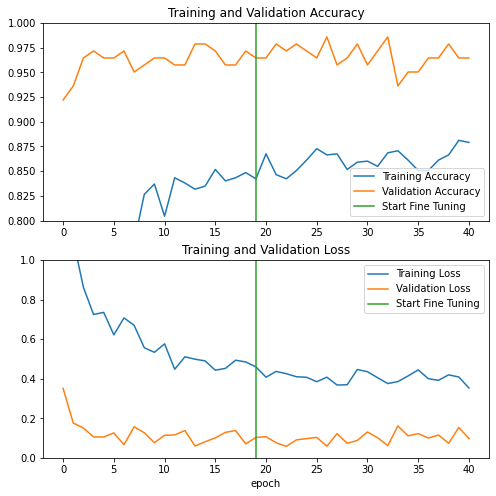

In [94]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [95]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 0s 334ms/step - loss: 0.2183 - accuracy: 0.9375
Test accuracy : 0.9375


Performances are slicy worst than ResNet50. However, training are more shorter than ResNet50 and VGG19. Currently, this model represents the best compromise between performance and time training. 

In [96]:
del model
del base_model
del history
del loss0, accuracy0
del accuracy

gc.collect()

110785

## 5) Transfer Learning with EfficientNet

### Implementation

In [97]:
rescale = layers.Rescaling(1./255, offset=-1)
preprocess_input = keras.applications.efficientnet.preprocess_input
base_model = keras.applications.efficientnet.EfficientNetB7(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [98]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)

In [99]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [100]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 4
Number of test batches: 1


In [101]:
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2560)


In [102]:
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 7)


In [103]:
for layer in base_model.layers[:10]:
  base_model.trainable = False

In [104]:
base_model.summary()

Model: "efficientnetb7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_9 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_5 (Rescaling)        (None, 224, 224, 3)  0           ['input_9[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 224, 224, 3)  7           ['rescaling_5[0][0]']            
                                                                                                  
 stem_conv_pad (ZeroPadding2D)  (None, 225, 225, 3)  0           ['normalization[0][0

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.364341 to fit



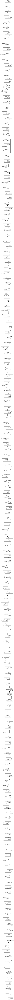

In [105]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

In [106]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [107]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [108]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)

print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
30/30 [==============================] - 29s 409ms/step - loss: 1.3193 - accuracy: 0.5489 - val_loss: 0.4706 - val_accuracy: 0.9633
Epoch 2/20
30/30 [==============================] - 8s 258ms/step - loss: 0.6003 - accuracy: 0.8275 - val_loss: 0.1947 - val_accuracy: 0.9817
Epoch 3/20
30/30 [==============================] - 8s 258ms/step - loss: 0.4181 - accuracy: 0.8707 - val_loss: 0.1526 - val_accuracy: 0.9633
Epoch 4/20
30/30 [==============================] - 8s 258ms/step - loss: 0.3685 - accuracy: 0.8749 - val_loss: 0.1121 - val_accuracy: 0.9817
Epoch 5/20
30/30 [==============================] - 8s 258ms/step - loss: 0.3422 - accuracy: 0.8854 - val_loss: 0.1380 - val_accuracy: 0.9725
Epoch 6/20
30/30 [==============================] - 8s 259ms/step - loss: 0.3308 - accuracy: 0.8938 - val_loss: 0.1272 - val_accuracy: 0.9633
Epoch 7/20
30/30 [==============================] - 8s 257ms/step - loss: 0.3220 - accuracy: 0.8896 - val_loss: 0.1390 - val_accuracy: 0.9450
Epoch

In [109]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

4/4 [==============================] - 1s 180ms/step - loss: 0.0986 - accuracy: 0.9541
initial loss: 0.10
initial accuracy: 0.95


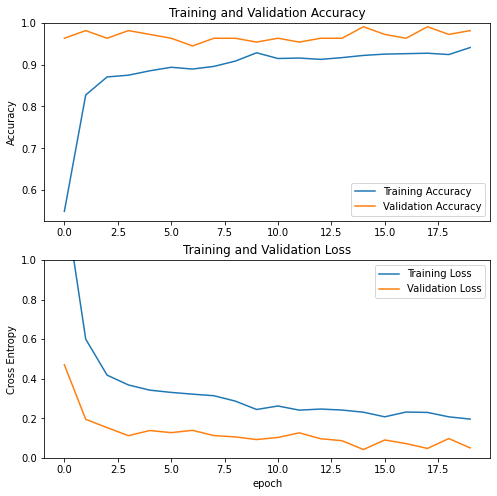

In [110]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### Fine-tuning

In [111]:
base_model.trainable = True

In [112]:
# Fine-tune from this layer onwards
fine_tune_at = 10

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

In [113]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)


print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
30/30 [==============================] - 8s 257ms/step - loss: 0.2123 - accuracy: 0.9317 - val_loss: 0.0682 - val_accuracy: 0.9633
Epoch 21/40
30/30 [==============================] - 8s 258ms/step - loss: 0.2272 - accuracy: 0.9253 - val_loss: 0.0533 - val_accuracy: 0.9908
Epoch 22/40
30/30 [==============================] - 8s 258ms/step - loss: 0.2056 - accuracy: 0.9264 - val_loss: 0.1196 - val_accuracy: 0.9633
Epoch 23/40
30/30 [==============================] - 8s 258ms/step - loss: 0.1902 - accuracy: 0.9327 - val_loss: 0.1285 - val_accuracy: 0.9633
Epoch 24/40
30/30 [==============================] - 8s 258ms/step - loss: 0.2036 - accuracy: 0.9306 - val_loss: 0.0407 - val_accuracy: 0.9908
Epoch 25/40
30/30 [==============================] - 8s 259ms/step - loss: 0.2069 - accuracy: 0.9222 - val_loss: 0.0975 - val_accuracy: 0.9725
Epoch 26/40
30/30 [==============================] - 8s 257ms/step - loss: 0.1991 - accuracy: 0.9253 - val_loss: 0.0971 - val_accuracy: 0.9725

In [114]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

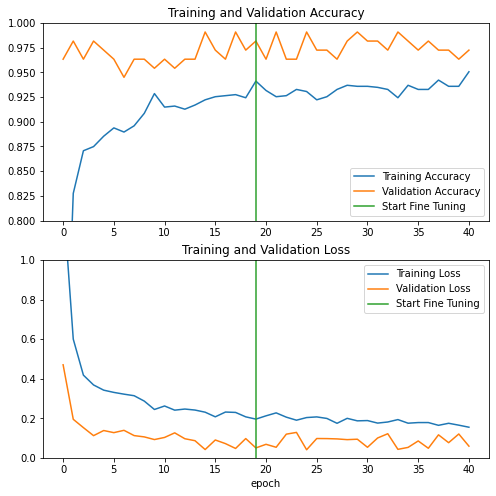

In [115]:
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [116]:
loss, accuracy = model.evaluate(test_set)
print('Test accuracy :', accuracy)

1/1 [==============================] - 1s 523ms/step - loss: 0.0496 - accuracy: 1.0000
Test accuracy : 1.0


In [117]:
del loss, accuracy
del model
del base_model
del history
del train_set
del test_set
del val_set

gc.collect()

13253

# Generalization with 120 breeds

### 1) Data augmentation & preprocessing

In [118]:
path = '/content/drive/My Drive/Ingénieur ML - OC/P6/datasets/Images'
img_width, img_height = 224, 224
channels = 3
batch_size = 32
image_arr_size= img_width * img_height * channels

In [119]:
# Creating a train set
train_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="training",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 20580 files belonging to 120 classes.
Using 16464 files for training.


In [120]:
# Creating a validation set
val_set = image_dataset_from_directory(
    path,
    validation_split=0.2,
    subset="validation",
    seed=42,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 20580 files belonging to 120 classes.
Using 4116 files for validation.


In [121]:
# Displaying names of breed
class_names = val_set.class_names
print(class_names)

['n02085620-Chihuahua', 'n02085782-Japanese_spaniel', 'n02085936-Maltese_dog', 'n02086079-Pekinese', 'n02086240-Shih-Tzu', 'n02086646-Blenheim_spaniel', 'n02086910-papillon', 'n02087046-toy_terrier', 'n02087394-Rhodesian_ridgeback', 'n02088094-Afghan_hound', 'n02088238-basset', 'n02088364-beagle', 'n02088466-bloodhound', 'n02088632-bluetick', 'n02089078-black-and-tan_coonhound', 'n02089867-Walker_hound', 'n02089973-English_foxhound', 'n02090379-redbone', 'n02090622-borzoi', 'n02090721-Irish_wolfhound', 'n02091032-Italian_greyhound', 'n02091134-whippet', 'n02091244-Ibizan_hound', 'n02091467-Norwegian_elkhound', 'n02091635-otterhound', 'n02091831-Saluki', 'n02092002-Scottish_deerhound', 'n02092339-Weimaraner', 'n02093256-Staffordshire_bullterrier', 'n02093428-American_Staffordshire_terrier', 'n02093647-Bedlington_terrier', 'n02093754-Border_terrier', 'n02093859-Kerry_blue_terrier', 'n02093991-Irish_terrier', 'n02094114-Norfolk_terrier', 'n02094258-Norwich_terrier', 'n02094433-Yorkshire_t

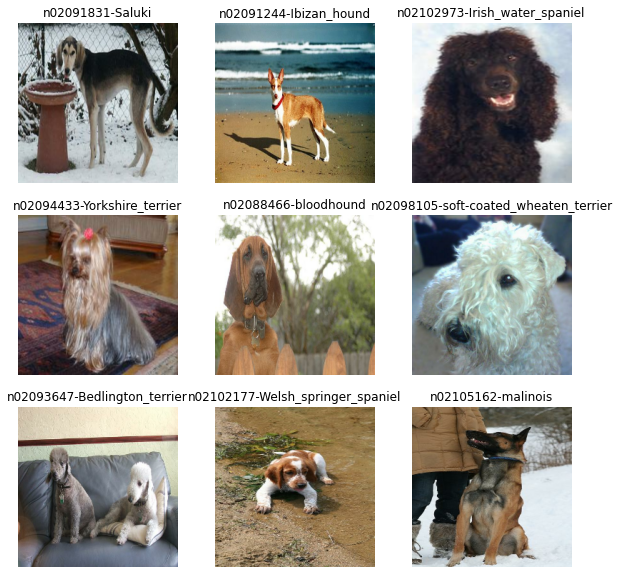

In [122]:
# Displaying some pictures of train set
plt.figure(figsize=(10, 10))
for images, labels in train_set.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

In [123]:
val_batches = experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

In [124]:
print('Number of validation batches: %d' % experimental.cardinality(val_set))
print('Number of test batches: %d' % experimental.cardinality(test_set))

Number of validation batches: 104
Number of test batches: 25


In [125]:
AUTOTUNE = tf.data.AUTOTUNE

train_set = train_set.prefetch(buffer_size=AUTOTUNE)
val_set = val_set.prefetch(buffer_size=AUTOTUNE)
test_set = test_set.prefetch(buffer_size=AUTOTUNE)

In [126]:
data_augmentation = tf.keras.Sequential([
  layers.RandomFlip('horizontal_and_vertical', seed=42),
  layers.RandomRotation(0.2, seed=42),
  layers.RandomContrast(0.7, seed=42),
  layers.RandomTranslation(height_factor=(-0.2, 0.3),
                           width_factor=(-0.2, 0.3),
                           fill_mode='reflect', seed=42)
])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


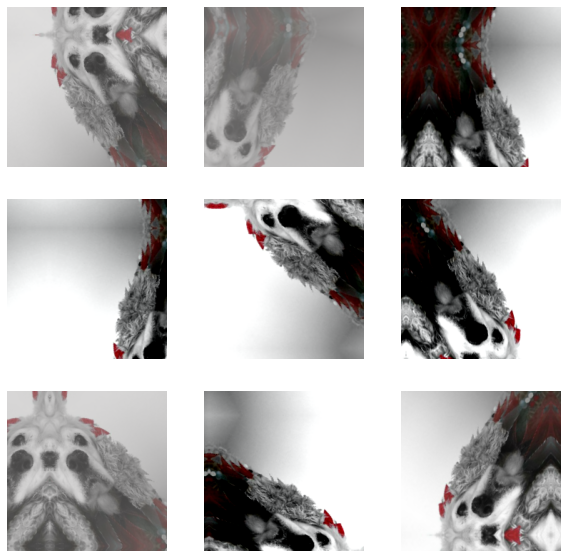

In [127]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

### 2) Modelisation with Inception V3

#### Model configuration & training

In [128]:
img_shape = img_height, img_width, channels
num_classes = 120

In [129]:
rescale = layers.Rescaling(1./255, offset=-1)

In [130]:
preprocess_input = keras.applications.inception_v3.preprocess_input
base_model = keras.applications.inception_v3.InceptionV3(
    weights="imagenet",
    input_shape= img_shape,
    include_top=False)

In [131]:
image_batch, label_batch = next(iter(train_set))
feature_batch = base_model(image_batch)
global_average_layer = layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(32, 2048)


In [132]:
num_classes=120
prediction_layer = layers.Dense(num_classes, activation="softmax")
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(32, 120)


In [133]:
for layer in base_model.layers[:15]:
  base_model.trainable = False

In [134]:
base_model.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_100 (Conv2D)            (None, 111, 111, 32  864         ['input_11[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_94 (BatchN  (None, 111, 111, 32  96         ['conv2d_100[0][0]']             
 ormalization)                  )                                                      

In [135]:
SVG(model_to_dot(base_model).create(prog='dot', format='svg'))
plot_model(base_model, show_shapes=True, show_layer_names=True, expand_nested=True)

- Model compilation

In [136]:
inputs = tf.keras.Input(shape=(img_height, img_width, channels))
x = data_augmentation(inputs)
x = preprocess_input(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.7)(x)
x = layers.Flatten()(x)
outputs = prediction_layer(x)
model = keras.Model(inputs, outputs)

In [137]:
model.compile(
  optimizer='adam',
  loss='sparse_categorical_crossentropy',
  metrics=['accuracy'])

In [138]:
t0 = time()

epochs = 20

history = model.fit(
  train_set,
  validation_data=val_set,
  epochs=epochs)


print("Done in %0.3fs." % (time() - t0))

Epoch 1/20
515/515 [==============================] - 41s 72ms/step - loss: 4.6703 - accuracy: 0.1681 - val_loss: 0.8208 - val_accuracy: 0.7624
Epoch 2/20
515/515 [==============================] - 36s 69ms/step - loss: 3.8549 - accuracy: 0.2742 - val_loss: 0.7181 - val_accuracy: 0.7859
Epoch 3/20
515/515 [==============================] - 36s 69ms/step - loss: 3.7740 - accuracy: 0.3019 - val_loss: 0.6963 - val_accuracy: 0.7916
Epoch 4/20
515/515 [==============================] - 36s 69ms/step - loss: 3.7146 - accuracy: 0.3078 - val_loss: 0.7073 - val_accuracy: 0.7859
Epoch 5/20
515/515 [==============================] - 36s 69ms/step - loss: 3.7538 - accuracy: 0.3155 - val_loss: 0.7306 - val_accuracy: 0.7829
Epoch 6/20
515/515 [==============================] - 36s 68ms/step - loss: 3.7982 - accuracy: 0.3158 - val_loss: 0.6870 - val_accuracy: 0.8010
Epoch 7/20
515/515 [==============================] - 36s 69ms/step - loss: 3.7547 - accuracy: 0.3206 - val_loss: 0.6840 - val_accuracy:

In [139]:
initial_epochs = 20

loss0, accuracy0 = model.evaluate(val_set)
print("initial loss: {:.2f}".format(loss0))
print("initial accuracy: {:.2f}".format(accuracy0))

104/104 [==============================] - 7s 51ms/step - loss: 0.7212 - accuracy: 0.8001
initial loss: 0.72
initial accuracy: 0.80


#### Accuracy and loss

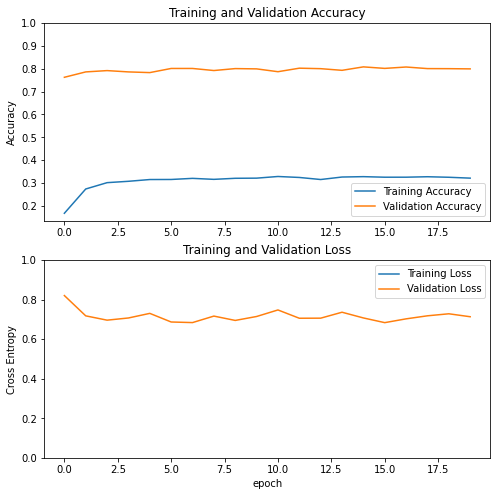

In [140]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

### 3) Fine-tuning

In [141]:
base_model.trainable = True

In [142]:
# Let's take a look to see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 25

# Freeze all the layers before the 'fine_tune_at' layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  311


In [143]:
fine_tune_epochs = 20
total_epochs =  initial_epochs + fine_tune_epochs

t0 = time()

history_fine = model.fit(train_set,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_set)

print("Done in %0.3fs." % (time() - t0))

Epoch 20/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9167 - accuracy: 0.3281 - val_loss: 0.7209 - val_accuracy: 0.8037
Epoch 21/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9231 - accuracy: 0.3234 - val_loss: 0.7330 - val_accuracy: 0.8001
Epoch 22/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9098 - accuracy: 0.3231 - val_loss: 0.7375 - val_accuracy: 0.7961
Epoch 23/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9307 - accuracy: 0.3254 - val_loss: 0.7043 - val_accuracy: 0.8067
Epoch 24/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9359 - accuracy: 0.3297 - val_loss: 0.7023 - val_accuracy: 0.8037
Epoch 25/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9712 - accuracy: 0.3259 - val_loss: 0.7262 - val_accuracy: 0.8010
Epoch 26/40
515/515 [==============================] - 36s 69ms/step - loss: 3.9762 - accuracy: 0.3248 - val_loss: 0.7073 - val_ac

In [144]:
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

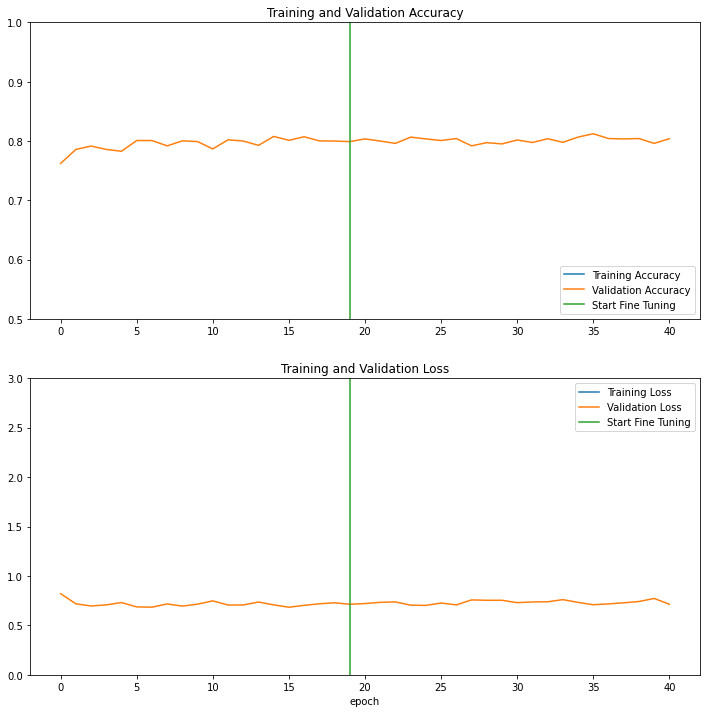

In [145]:
plt.figure(figsize=(12, 12))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.5, 1])
plt.plot([initial_epochs-1,initial_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 3.0])
plt.plot([initial_epochs-1,initial_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

In [146]:
loss, accuracy = model.evaluate(test_set)

25/25 [==============================] - 2s 53ms/step - loss: 0.8224 - accuracy: 0.7713


#### Evaluation performance

In [147]:
print('Test accuracy :', round(accuracy, 3))

Test accuracy : 0.771


In [148]:
preds = model.predict(test_set, verbose = 1)

25/25 [==============================] - 3s 48ms/step


In [149]:
pred_labels = tf.argmax(preds, axis=1)

In [150]:
test_labels = np.concatenate([y for x, y in test_set], axis=0)

In [151]:
from sklearn.metrics import classification_report

report = classification_report(test_labels, pred_labels, output_dict=True)

In [152]:
f1scores = {}
for k,v in report.items():
    if k == 'accuracy':
        break
    else:
        f1scores[class_names[int(k)]] = v['f1-score']

In [153]:
F1 = pd.DataFrame({"Classes":list(f1scores.keys()),
                   "F1-Scores":list(f1scores.values())}).sort_values("F1-Scores", ascending=False)

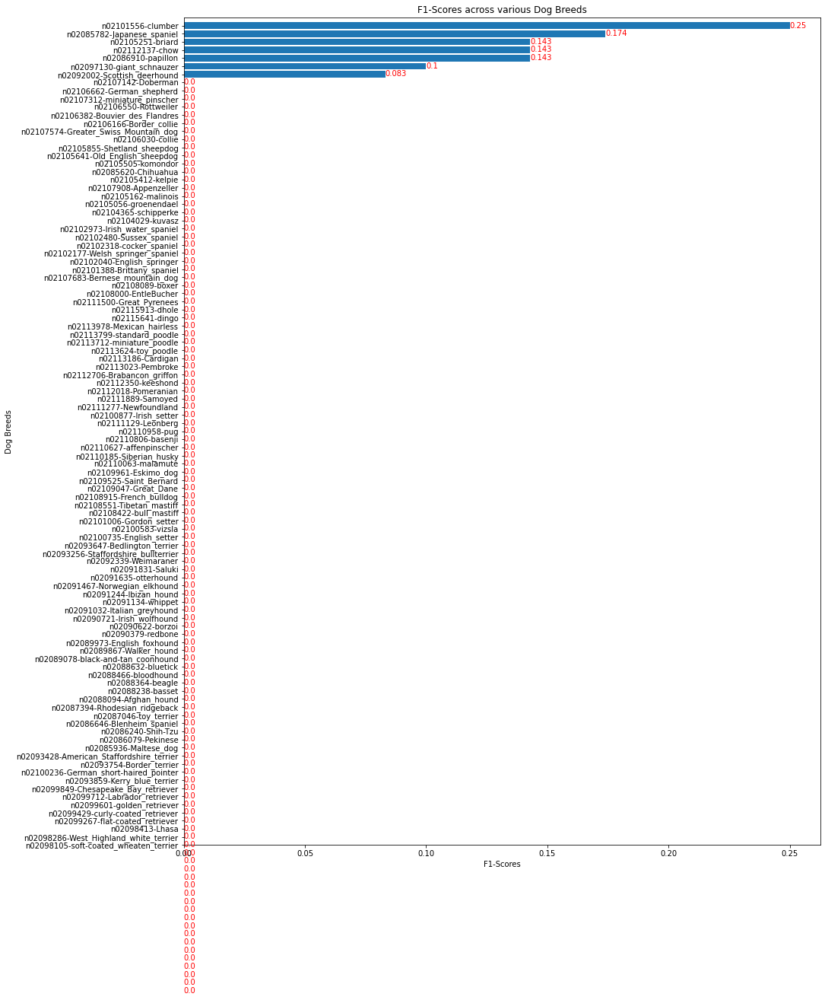

In [154]:
fig, ax = plt.subplots(figsize = (15,20))
plt.barh(F1["Classes"], F1["F1-Scores"])
plt.ylim(-1,101)
plt.xlabel("F1-Scores")
plt.ylabel("Dog Breeds")
plt.title("F1-Scores across various Dog Breeds")
plt.gca().invert_yaxis()
for i, v in enumerate(round(F1["F1-Scores"],3)):
    ax.text(v, i + .25, str(v), color='red')

#### Saving Model

In [155]:
model.save("/content/drive/My Drive/Ingénieur ML - OC/P6/my_model.h5")

### 4) New prediction with new data

In [156]:
with open("/content/drive/My Drive/Ingénieur ML - OC/P6/dogs_name.txt", "w") as output:
    output.write(str(class_names))

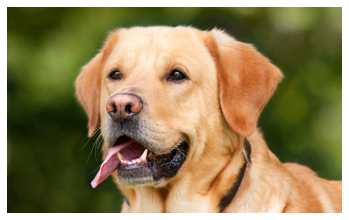

In [157]:
from tensorflow.keras.utils import load_img, img_to_array

path_test = "/content/drive/My Drive/Ingénieur ML - OC/P6/test.jpg"
test = load_img(path_test)

plt.axis("off")
plt.imshow(test)

In [158]:
import cv2

img_test = img_to_array(test)
img_test = cv2.resize(img_test,(224,224))
img_test = img_test.reshape(1,224,224,3)
predictions = model.predict(img_test)
pred = tf.nn.softmax(predictions[0])
print("This image belongs to {}.".format(class_names[np.argmax(pred)])) 

This image belongs to n02099601-golden_retriever.


# Ressources

*Image preprocessing*
- https://hadrienj.github.io/posts/Preprocessing-for-deep-learning/
- https://www.kaggle.com/nicw102168/exploring-zca-and-color-image-whitening

*Utilis.*
- https://www.tensorflow.org/tutorials/load_data/images

*Deep Learning Modelisation, CNN & Transfer Learning*
- https://www.tensorflow.org/tutorials/images/classification
- https://www.tensorflow.org/tutorials/images/transfer_learning
- https://keras.io/guides/transfer_learning/
- *Deep Learning with TensorFlow*, 2nd Edition, François Chollet
- https://arxiv.org/abs/1512.00567v3

*Deployment*
- GitHub : https://github.com/Sylvariane/classification_image_deep_learning
- API (online): https://share.streamlit.io/sylvariane/classification_image_deep_learning/main/P06_02_programme.py